# Debugging my Bike ridership prediction model

In [1]:
import pandas as pd
import numpy as np
from pathlib import Path 
from pyprojroot import here
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.metrics import mean_absolute_error 
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from yellowbrick.regressor import ResidualsPlot, PredictionError, residuals_plot, prediction_error
import yellowbrick as yb
import matplotlib.pyplot as plt

ModuleNotFoundError: No module named 'seaborn'

## Load the data

In [3]:
BASE_PATH = here(r'/home/aiwayemi/data_science/Data-Science-Projects/bluebike_availability_prediction/data')
DATA_FILE = BASE_PATH / 'processed/hourly_ridership_data/station_67__2017_ridership_data.csv'
data_df = pd.read_csv(DATA_FILE, parse_dates=True)
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6243 entries, 0 to 6242
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Unnamed: 0            6243 non-null   int64  
 1   start station id      6243 non-null   int64  
 2   total_trips           6243 non-null   int64  
 3   num_subscriber_trips  6243 non-null   int64  
 4   num_customer_trips    6243 non-null   int64  
 5   hour_of_day           6243 non-null   float64
 6   day_of_week           6243 non-null   float64
 7   day                   6243 non-null   object 
 8   month                 6243 non-null   float64
 9   is_weekend            6243 non-null   bool   
 10  hour_sine             6243 non-null   float64
 11  hour_cos              6243 non-null   float64
 12  month_sine            6243 non-null   float64
 13  month_cos             6243 non-null   float64
 14  day_of_week_sine      6243 non-null   float64
 15  day_of_week_cos      

In [4]:
data_columns = data_df.columns[2:]
data_columns

Index(['total_trips', 'num_subscriber_trips', 'num_customer_trips',
       'hour_of_day', 'day_of_week', 'day', 'month', 'is_weekend', 'hour_sine',
       'hour_cos', 'month_sine', 'month_cos', 'day_of_week_sine',
       'day_of_week_cos', 'summary', 'temperature', 'humidity', 'pressure',
       'windSpeed', 'precipIntensity', 'visibility', 'cloudCover', 'uvIndex'],
      dtype='object')

In [5]:
data_df.head()

,Unnamed: 0,start station id,total_trips,num_subscriber_trips,num_customer_trips,hour_of_day,day_of_week,day,month,is_weekend,...,day_of_week_cos,summary,temperature,humidity,pressure,windSpeed,precipIntensity,visibility,cloudCover,uvIndex
0,14,67,16,15,1,17.0,3.0,Thursday,3.0,False,...,-0.900969,Partly Cloudy,47.76,0.23,1011.7,9.32,0.0000,9.966,0.37,0
1,73,67,3,3,0,14.0,1.0,Tuesday,3.0,False,...,0.623490,Mostly Cloudy,52.54,0.33,1009.8,4.17,0.0000,9.966,0.79,4
2,130,67,20,17,3,17.0,1.0,Tuesday,3.0,False,...,0.623490,Mostly Cloudy,53.93,0.37,1007.8,4.94,0.0000,9.966,0.67,1
3,196,67,6,6,0,17.0,0.0,Monday,3.0,False,...,1.000000,Overcast,43.39,0.92,1015.5,1.76,0.0058,9.148,1.00,1
4,258,67,4,4,0,17.0,1.0,Tuesday,3.0,False,...,0.623490,Light Rain,39.72,0.93,1015.0,2.08,0.0154,5.712,1.00,1


In [6]:
data_sample = data_df[data_columns].sample(1000, random_state=10)

In [7]:
data_sample.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 5000 to 1920
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_trips           1000 non-null   int64  
 1   num_subscriber_trips  1000 non-null   int64  
 2   num_customer_trips    1000 non-null   int64  
 3   hour_of_day           1000 non-null   float64
 4   day_of_week           1000 non-null   float64
 5   day                   1000 non-null   object 
 6   month                 1000 non-null   float64
 7   is_weekend            1000 non-null   bool   
 8   hour_sine             1000 non-null   float64
 9   hour_cos              1000 non-null   float64
 10  month_sine            1000 non-null   float64
 11  month_cos             1000 non-null   float64
 12  day_of_week_sine      1000 non-null   float64
 13  day_of_week_cos       1000 non-null   float64
 14  summary               1000 non-null   object 
 15  temperature       

## Explore the data

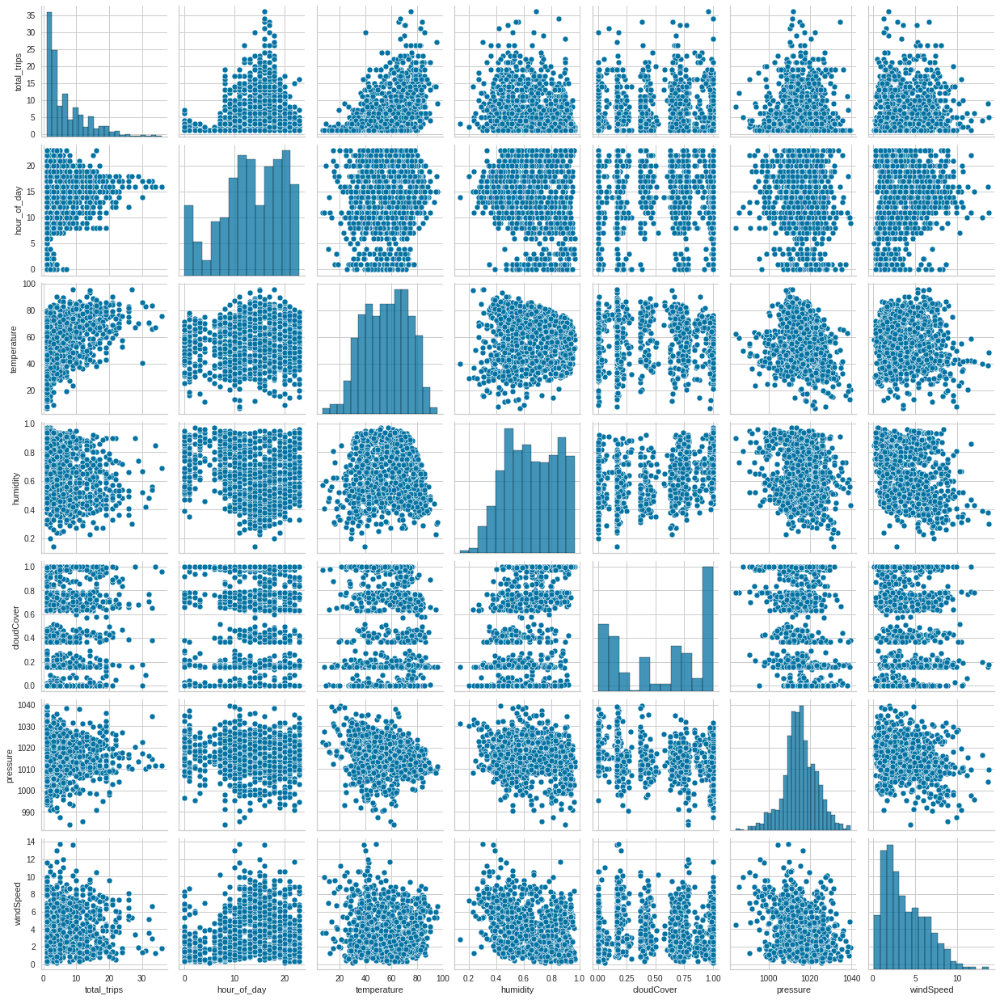

In [16]:
sns.pairplot(data=data_sample[['total_trips', 'hour_of_day', 'day', 'summary', 'temperature', 'humidity', 'cloudCover', 'pressure', 'windSpeed']])

In [17]:
data_sample.columns

Index(['total_trips', 'num_subscriber_trips', 'num_customer_trips',
       'hour_of_day', 'day_of_week', 'day', 'month', 'is_weekend', 'hour_sine',
       'hour_cos', 'month_sine', 'month_cos', 'day_of_week_sine',
       'day_of_week_cos', 'summary', 'temperature', 'humidity', 'pressure',
       'windSpeed', 'precipIntensity', 'visibility', 'cloudCover', 'uvIndex'],
      dtype='object')

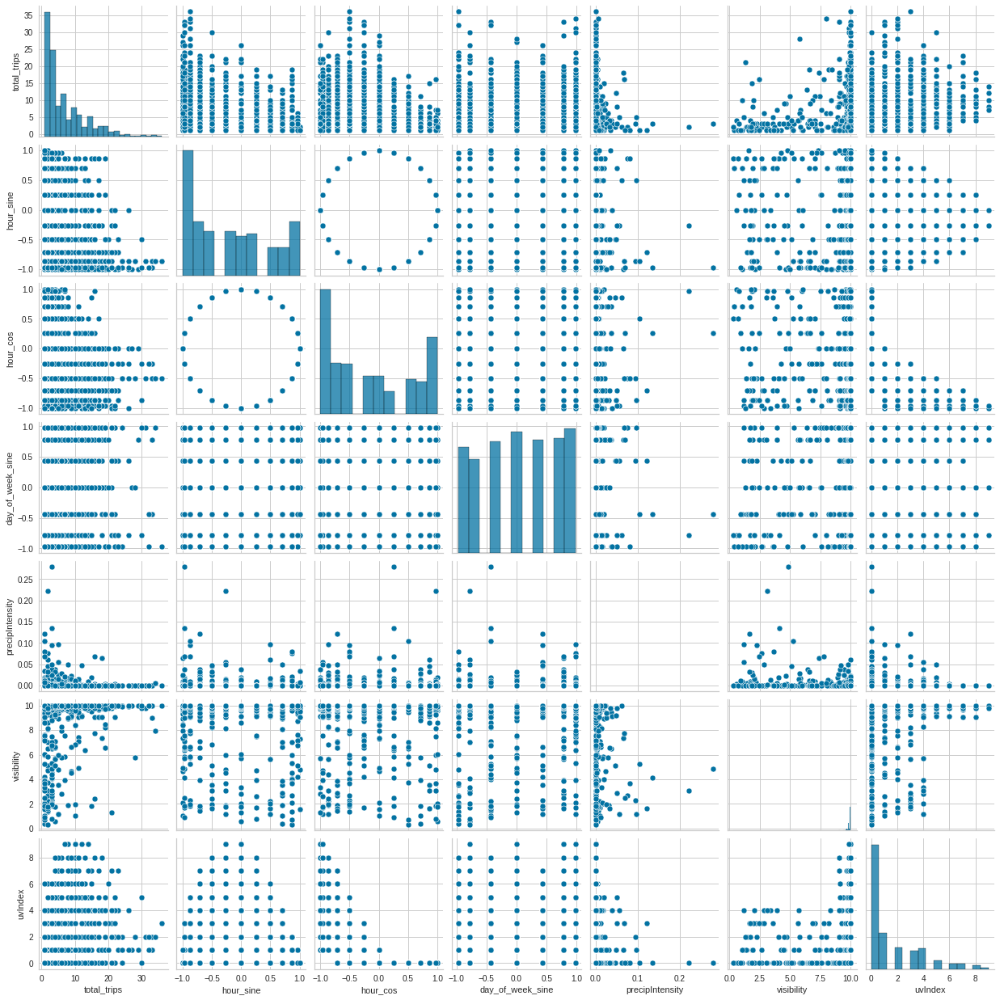

In [20]:
sns.pairplot(data=data_sample[['total_trips', 'hour_sine', 'hour_cos', 'day_of_week_sine', 'precipIntensity', 'visibility', 'uvIndex']])

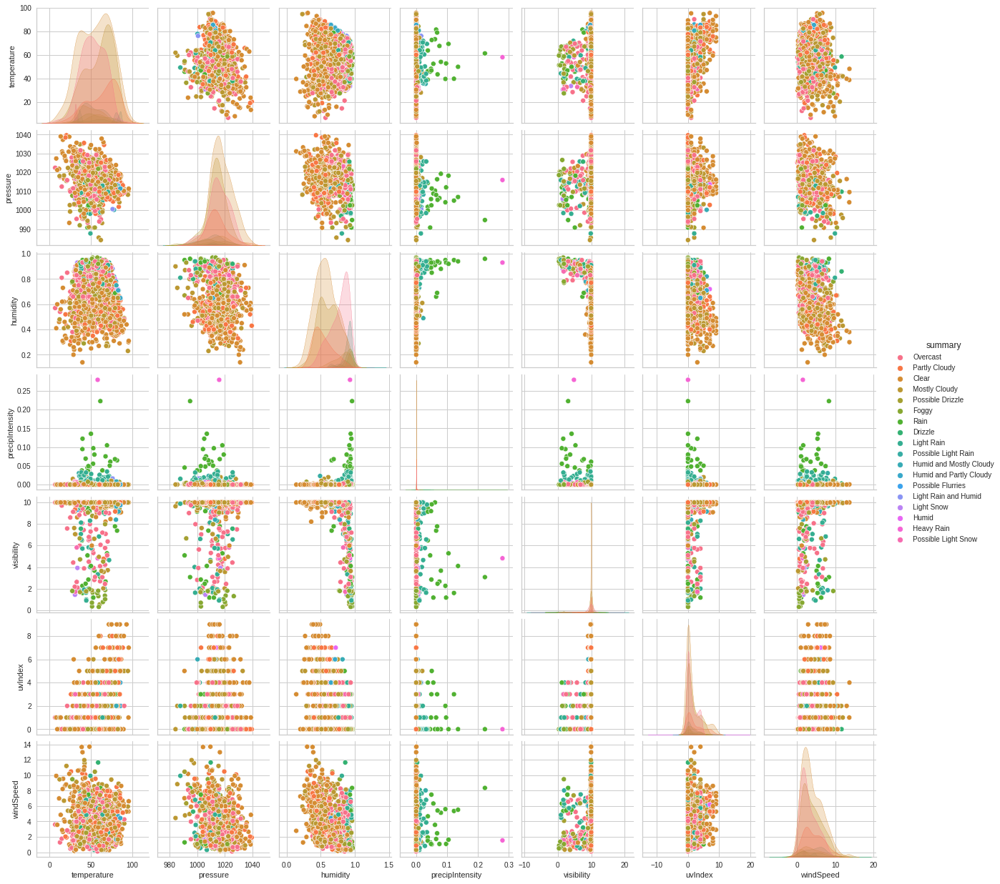

In [22]:
# Explore how the the weather summary is correlated with the individual measurements
sns.pairplot(data=data_sample[['summary', 'temperature', 'pressure', 'humidity', 'precipIntensity', 'visibility', 'uvIndex', 'windSpeed']], hue='summary')

In [10]:
# How does ridership change with weather?
data_sample.groupby(['summary']).agg({'total_trips': sum, 'num_subscriber_trips': sum, 'num_customer_trips': sum})

,total_trips,num_subscriber_trips,num_customer_trips
summary,,,
Clear,2186,1898,288
Drizzle,57,54,3
Foggy,73,70,3
Heavy Rain,3,3,0
Humid,24,15,9
Humid and Mostly Cloudy,35,28,7
Humid and Partly Cloudy,53,51,2
Light Rain,157,152,5
Light Rain and Humid,9,6,3


In [11]:
data_sample.groupby(['is_weekend']).agg({'total_trips': sum, 'num_subscriber_trips': sum, 'num_customer_trips': sum})

,total_trips,num_subscriber_trips,num_customer_trips
is_weekend,,,
False,5204,4708,496
True,1671,1217,454


## Model building

In [23]:
data_columns

Index(['total_trips', 'num_subscriber_trips', 'num_customer_trips',
       'hour_of_day', 'day_of_week', 'day', 'month', 'is_weekend', 'hour_sine',
       'hour_cos', 'month_sine', 'month_cos', 'day_of_week_sine',
       'day_of_week_cos', 'summary', 'temperature', 'humidity', 'pressure',
       'windSpeed', 'precipIntensity', 'visibility', 'cloudCover', 'uvIndex'],
      dtype='object')

In [30]:
# These are the most promising features. Exclude 'summary' feature until I convert it to a categorical feature
features = ['hour_of_day', 'day_of_week', 'is_weekend',  'temperature', 'pressure',
       'precipIntensity', 'visibility', 'uvIndex']

X_train, X_test, y_train, y_test = train_test_split(data_df[features], data_df['total_trips'], random_state=10)

In [31]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4682 entries, 680 to 1289
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   hour_of_day      4682 non-null   float64
 1   day_of_week      4682 non-null   float64
 2   is_weekend       4682 non-null   bool   
 3   temperature      4682 non-null   float64
 4   pressure         4682 non-null   float64
 5   precipIntensity  4682 non-null   float64
 6   visibility       4682 non-null   float64
 7   uvIndex          4682 non-null   int64  
dtypes: bool(1), float64(6), int64(1)
memory usage: 297.2 KB


In [32]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1561 entries, 5000 to 3138
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   hour_of_day      1561 non-null   float64
 1   day_of_week      1561 non-null   float64
 2   is_weekend       1561 non-null   bool   
 3   temperature      1561 non-null   float64
 4   pressure         1561 non-null   float64
 5   precipIntensity  1561 non-null   float64
 6   visibility       1561 non-null   float64
 7   uvIndex          1561 non-null   int64  
dtypes: bool(1), float64(6), int64(1)
memory usage: 99.1 KB


In [33]:
decision_tree_model = DecisionTreeRegressor()
decision_tree_model.fit(X_train, y_train)
y_prediction = decision_tree_model.predict(X_test)
mae_value = mean_absolute_error(y_test, y_prediction)
print(f"MAE: {mae_value}")

MAE: 3.572709801409353


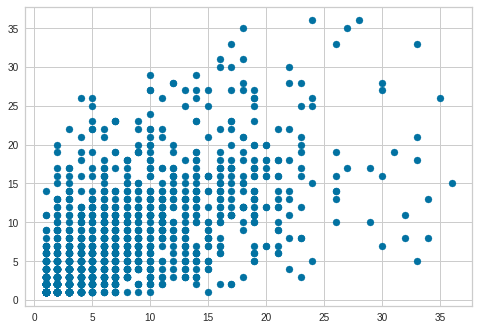

In [34]:
plt.scatter(y_test, y_prediction)

In [43]:
results_df = pd.DataFrame({'True value': y_test, 'Predicted_value': y_prediction, 'Error_pct': 100 * np.abs(y_test - y_prediction)/y_test })

In [44]:
results_df.head(20)

,True value,Predicted_value,Error_pct
5000,6,2.0,66.666667
2153,4,9.0,125.000000
2878,4,1.0,75.000000
4858,1,3.0,200.000000
655,2,5.0,150.000000
330,21,14.0,33.333333
3980,4,3.0,25.000000
5467,1,2.0,100.000000
558,5,4.0,20.000000
4944,2,1.0,50.000000


In [45]:
results_df['Error_pct'].mean()

74.44302696074985

In [47]:
# In how many cases is the error less than 20%
results_df.query('Error_pct <= 20 ')

,True value,Predicted_value,Error_pct
558,5,4.0,20.000000
3051,12,10.0,16.666667
5372,1,1.0,0.000000
2726,5,4.0,20.000000
961,3,3.0,0.000000
...,...,...,...
4324,11,9.0,18.181818
1948,23,20.0,13.043478
1003,10,11.0,10.000000
3764,6,5.0,16.666667


In [50]:
print(f"The percentage difference in the predictions is only less than 20% for {100 * len(results_df.query('Error_pct <= 20 '))/len(results_df):.02f}% of the data")

The percentage difference in the predictions is only less than 20% for 29.47% of the data


### Questions

When does the DecisionTree do well and why?

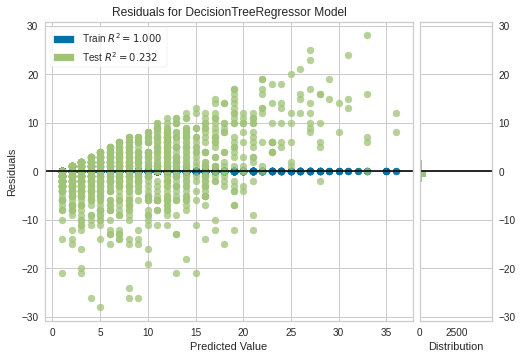

ResidualsPlot(ax=<AxesSubplot:title={'center':'Residuals for DecisionTreeRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>,
              line_color=None, model=None, test_alpha=None, test_color=None,
              train_alpha=None, train_color=None)

In [56]:
# Plot the residuals
residuals_plot(DecisionTreeRegressor(), X_train, y_train, X_test, y_test)

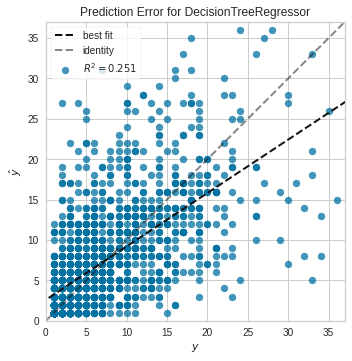

PredictionError(ax=<AxesSubplot:title={'center':'Prediction Error for DecisionTreeRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>,
                model=None)

In [58]:
prediction_error(DecisionTreeRegressor(), X_train, y_train, X_test, y_test)

## What is the impact of using a RF Regressor on model accuracy?

In [62]:
rf_regressor = RandomForestRegressor()
rf_regressor.fit(X_train, y_train)
rf_predictions = rf_regressor.predict(X_test)
rf_mae = mean_absolute_error(y_test, rf_predictions)
print(f'RF regressor MAE: {rf_mae}')

RF regressor MAE: 2.721159513132607


In [72]:
rf_results_df = pd.DataFrame({'True value': y_test, 'Predicted_value': rf_predictions, 'Error_pct': 100 * np.abs(y_test - rf_predictions)/y_test })
rf_results_df.sample(10)

,True value,Predicted_value,Error_pct
4292,8,4.04,49.500000
694,1,1.40,40.000000
2529,6,8.13,35.500000
2717,4,8.19,104.750000
146,5,3.95,21.000000
2294,4,5.84,46.000000
2719,4,14.04,251.000000
4645,16,12.44,22.250000
1109,4,8.87,121.750000
3432,22,13.24,39.818182


In [67]:
rf_results_df['Error_pct'].mean()

62.88747289264437

In [68]:
print(f"The percentage difference in the predictions is only less than 20% for {100 * len(rf_results_df.query('Error_pct <= 20 '))/len(rf_results_df):.02f}% of the data")

The percentage difference in the predictions is only less than 20% for 28.12% of the data


In [70]:
print(f"The percentage difference in the predictions is only less than 10% for {100 * len(rf_results_df.query('Error_pct <= 10 '))/len(rf_results_df):.02f}% of the data")

The percentage difference in the predictions is only less than 10% for 13.97% of the data


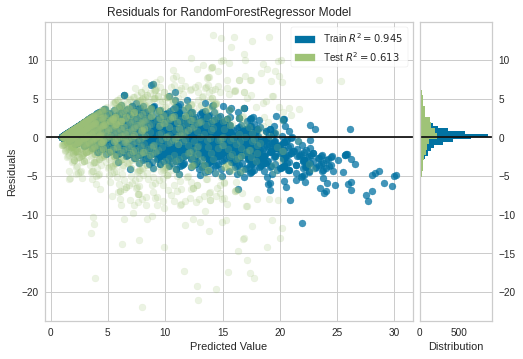

ResidualsPlot(ax=<AxesSubplot:title={'center':'Residuals for RandomForestRegressor Model'}, xlabel='Predicted Value', ylabel='Residuals'>,
              line_color=None, model=None, test_alpha=None, test_color=None,
              train_alpha=None, train_color=None)

In [74]:
residuals_plot(RandomForestRegressor(), X_train, y_train, X_test, y_test, test_alpha=0.2)

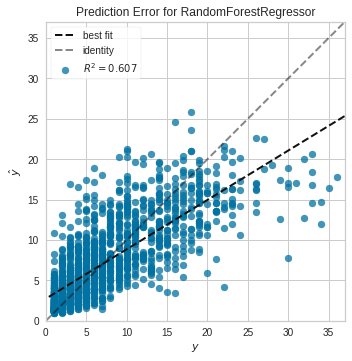

PredictionError(ax=<AxesSubplot:title={'center':'Prediction Error for RandomForestRegressor'}, xlabel='$y$', ylabel='$\\hat{y}$'>,
                model=None)

In [61]:
prediction_error(RandomForestRegressor(), X_train, y_train, X_test, y_test)

### Plan

Create a Streamlit tool for interactively performing ML model error analysis

#### Inputs 
* Data set (CSV)

__Dropdowns/selectors__
* SKLearn compatible Estimator (focus on Regression models for now): DecisionTree, RF, LightGBMRegressor
* Evaluation metric: 
    * MAE
    * RMSE


* A way to write text notes to describe why the ML model performed poorly on a particular prediction.  

#### Filters
* Error threshold (float)

#### Outputs: 
Charts:
* Residuals plot
* Prediction error plot

Table(s):
* A tabular view of the features that satisfy the selected error threshold
* Tabular view of predicted vs actual values